# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

# Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary. 

The business task of identifying key drivers for used car prices can be reframed as a data task of performing a 
regression analysis on a dataset of used car transactions to determine the variables that have the most significant
impact on the sale price of a used car. This involves collecting and cleaning data on various features of the car, 
such as make, model, year, mileage, condition, and location, as well as external factors that may influence the price,
such as economic indicators, consumer demand, and market trends. The data task also involves selecting an appropriate 
statistical model and methodology, and evaluating the models accuracy and predictive power using various metrics such 
as R-squared, mean absolute error, and root mean square error.

# Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

#### Data exploration

To get to know the dataset and identify any quality issues within, I would take the following steps:

1/ Obtain the dataset and read the data documentation: Get access to the dataset and read any available documentation that describes the data's structure, source, and format. This step will help to understand the data's background, and what each column represents.

2/ Explore the data: Examine the dataset by computing descriptive statistics (mean, median, mode, standard deviation, minimum, maximum) for each column. This will provide a general idea of the data range and any potential issues, such as outliers or missing values.

3/ Visualize the data: Generate different types of graphs, charts, and plots to better understand the dataset's distribution, patterns, and relationships between different variables. This will help to detect any anomalies or trends within the data.

4/ Check for missing data: Identify any missing values in the dataset, assess the percentage of missing data, and decide on the appropriate imputation strategy.

5/ Check for duplicates: Look for any duplicates within the dataset and determine the appropriate action to handle them.

6/ Identify outliers: Check for outliers within the dataset and determine if they are erroneous or genuine values. Decide on the appropriate action to handle outliers.

7/ Verify data accuracy: Verify that the data accurately reflects the real-world phenomenon and ensure that the data is consistent with the business requirements.

By conducting these steps, it will be possible to identify any quality issues within the dataset and clean the data, ensuring it is ready for use in subsequent data analysis and modeling.

In [1]:
# #  Steps followed in this analysis
# 1. Import the required libraries
# 2. Import the data
# 3. Data Preparation 
# 4. Feature Engineering - Handle outliers, handle missing data, handle Categorical variables
# 5. Visualize the relationship
# 6. Prepare for model training
# 7. Model building and eavaluation
# 7. Check for accuracy - MAE, MSE, RMSE, R2

In [2]:
# import the required libraries for the analysis
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import statsmodels.api as sm
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.model_selection import train_test_split
import warnings
import seaborn as sns
import plotly.express as px
from sklearn.preprocessing import PolynomialFeatures, StandardScaler, OneHotEncoder


warnings.filterwarnings('ignore')

In [3]:
#  Import the data and review it for the initiatial preparation for analysis
usedcar =  pd.read_csv('/Users/mohul1/Downloads/practical_application_II_starter/data/vehicles.csv')

In [4]:
usedcar.head()

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
0,7222695916,prescott,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,az
1,7218891961,fayetteville,11900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ar
2,7221797935,florida keys,21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fl
3,7222270760,worcester / central MA,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ma
4,7210384030,greensboro,4900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nc


In [5]:
usedcar.tail()

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
426875,7301591192,wyoming,23590,2019.0,nissan,maxima s sedan 4d,good,6 cylinders,gas,32226.0,clean,other,1N4AA6AV6KC367801,fwd,NaN,sedan,NaN,wy
426876,7301591187,wyoming,30590,2020.0,volvo,s60 t5 momentum sedan 4d,good,NaN,gas,12029.0,clean,other,7JR102FKXLG042696,fwd,NaN,sedan,red,wy
426877,7301591147,wyoming,34990,2020.0,cadillac,xt4 sport suv 4d,good,NaN,diesel,4174.0,clean,other,1GYFZFR46LF088296,NaN,NaN,hatchback,white,wy
426878,7301591140,wyoming,28990,2018.0,lexus,es 350 sedan 4d,good,6 cylinders,gas,30112.0,clean,other,58ABK1GG4JU103853,fwd,NaN,sedan,silver,wy
426879,7301591129,wyoming,30590,2019.0,bmw,4 series 430i gran coupe,good,NaN,gas,22716.0,clean,other,WBA4J1C58KBM14708,rwd,NaN,coupe,NaN,wy


In [6]:
# data types and number of rows & columns
usedcar.info(), usedcar.shape

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  VIN           265838 non-null  object 
 13  drive         296313 non-null  object 
 14  size          120519 non-null  object 
 15  type          334022 non-null  object 
 16  paint_color   296677 non-null  object 
 17  state         426880 non-null  object 
dtypes: f

(None, (426880, 18))

In [7]:
# #  Quick glance on the data:
# There are 426880 entries for 18 features of used cars
# There are 4 columns of integer/float datatype whereas rest 14 are object datatypes.

# # Next steps:-
# 1. Find and remove null values
# 2. Remove unwanted columns/features from the dataset
# 3. Varify categorical features

In [8]:
#  Find out the total null values
usedcar.isnull().sum()

id                   0
region               0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
VIN             161042
drive           130567
size            306361
type             92858
paint_color     130203
state                0
dtype: int64

In [9]:
usedcar.describe()

# PRICE AND ODOMETER SEEM TO HAVE SOME OUTLIERS AS THE MAX VALUE IS EXCEPTIONALLY HIGH AND MINIMUM IS CLOSE TO ZERO

,id,price,year,odometer
count,4.268800e+05,4.268800e+05,425675.000000,4.224800e+05
mean,7.311487e+09,7.519903e+04,2011.235191,9.804333e+04
std,4.473170e+06,1.218228e+07,9.452120,2.138815e+05
min,7.207408e+09,0.000000e+00,1900.000000,0.000000e+00
25%,7.308143e+09,5.900000e+03,2008.000000,3.770400e+04
50%,7.312621e+09,1.395000e+04,2013.000000,8.554800e+04
75%,7.315254e+09,2.648575e+04,2017.000000,1.335425e+05
max,7.317101e+09,3.736929e+09,2022.000000,1.000000e+07


### Data Preparation

After our initial exploration and fine tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`. 

In [10]:
# price - there are quite a bit of outliers
print(f'Number of rows without any price: ',(usedcar[usedcar['price'] == 0]).shape[0])
print(f'Number of rows price less than $100: ',(usedcar[usedcar['price'] < 100]).shape[0])

# drop 3090 rows with the price less than 100
usedcar.drop(usedcar[usedcar['price']<100].index, inplace=True)
usedcar.drop(usedcar[usedcar['price']>=999999].index, inplace=True)

usedcar.shape

Number of rows without any price:  32895
Number of rows price less than $100:  36222


(390597, 18)

In [11]:
#further outliers that do no make sense- cars with such high odometer reading as 1 million miles. In my opinion, 
# this is more than car's life
drop_odometer_index = usedcar[usedcar.odometer >= 1000000].index
print(drop_odometer_index)

# DROP THESE VALUES 

usedcar.drop((drop_odometer_index),inplace=True )
usedcar.shape


Int64Index([   455,    562,    616,   1115,   1440,   1729,   4614,   7657,
              9218,   9878,
            ...
            411561, 412634, 413267, 417631, 417643, 419355, 419494, 422547,
            423091, 426106],
           dtype='int64', length=502)


(390095, 18)

In [12]:
usedcar.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 390095 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            390095 non-null  int64  
 1   region        390095 non-null  object 
 2   price         390095 non-null  int64  
 3   year          388922 non-null  float64
 4   manufacturer  374391 non-null  object 
 5   model         385553 non-null  object 
 6   condition     240647 non-null  object 
 7   cylinders     231713 non-null  object 
 8   fuel          387502 non-null  object 
 9   odometer      387813 non-null  float64
 10  title_status  382368 non-null  object 
 11  transmission  388274 non-null  object 
 12  VIN           239984 non-null  object 
 13  drive         271351 non-null  object 
 14  size          108884 non-null  object 
 15  type          306023 non-null  object 
 16  paint_color   274610 non-null  object 
 17  state         390095 non-null  object 
dtypes: f

In [13]:
# # # Quick glance of the data with plot for all features
# sns.pairplot(usedcar)
# plt.show()

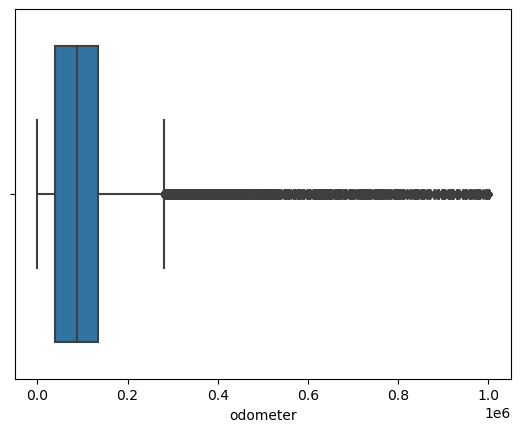

In [14]:
# for outliers in int fields - ODOMETER
sns.boxplot(usedcar['odometer'])
plt.show()

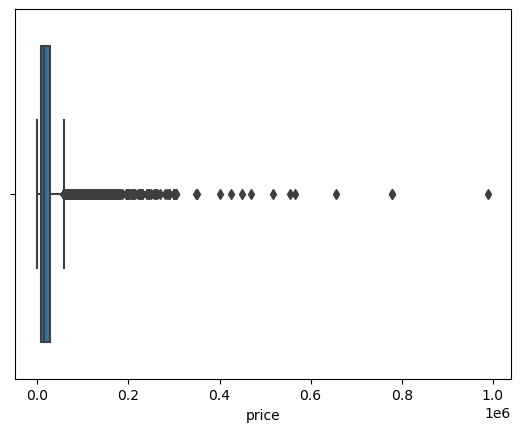

In [15]:
# for outliers in int fields - PRICE
sns.boxplot(usedcar['price'])
plt.show()

In [16]:
#  usedcar[usedcar.price >= 999999]

In [86]:
usedcar['fuel'].unique()

array(['0', '1', '3', '2', '4'], dtype=object)

In [85]:
# A Quick View into usedcar by Odometer vs. Fuel Type. This may indicate which types of cars have the most wear and tear
#box plot by odometer and fuel type
import plotly.express as px
fig = px.box(usedcar, x="fuel", y="odometer", color="size", title='Used cars by Odometer and Fuel Type')

# fig = px.scatter(usedcar, x='fuel', y="odometer")
fig.show()


In [18]:
# checking with "year" and "manfacturer"
fig = px.histogram(usedcar, x="year" , color='manufacturer', nbins=20, title="Cars by Year and Manufacturer")
fig.show()

# this shows "FORD" has highest market share followed by "CHEVROLET"

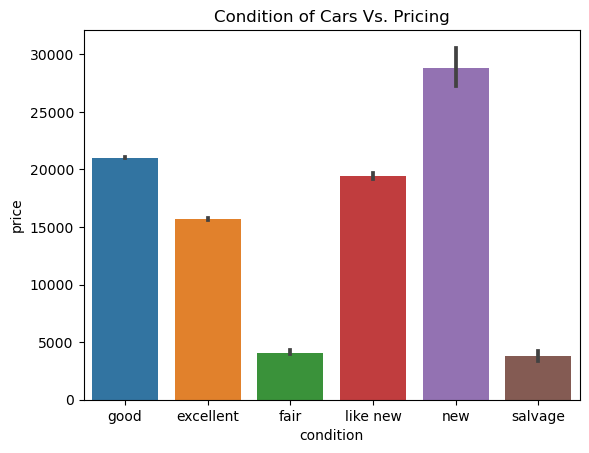

In [19]:
# Condition of used car and its influence on price
sns.barplot(data=usedcar, x='condition', y='price')
plt.title('Condition of Cars Vs. Pricing')
plt.show()

# sns.boxplot(data=data, x='condition', y='price').set(title='Condition vs Price')

# NEW/ LIKE NEW / GOOD conditined cars in demand compared to other used cars

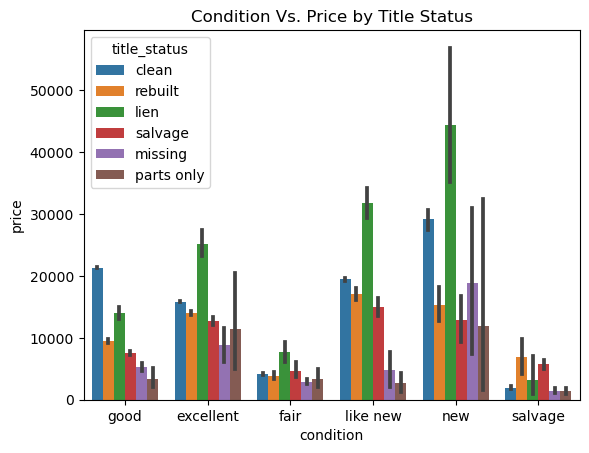

In [20]:
# A Look Into The Condition vs Title vs Price
sns.barplot(data=usedcar, x='condition', y='price', hue='title_status')
plt.title('Condition Vs. Price by Title Status')
plt.show()

# "LIEN" is leased car which is higher in most of the used car condition categories

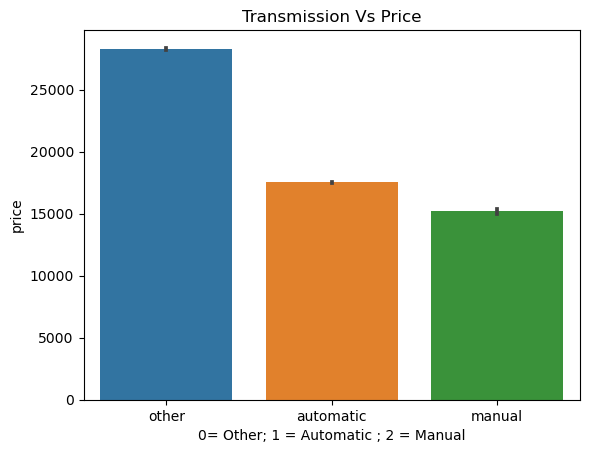

In [21]:
#Transmission of used car and its influence on price
sns.barplot(data=usedcar, x='transmission', y='price') 
plt.title('Transmission Vs Price')
plt.xlabel("0= Other; 1 = Automatic ; 2 = Manual")
plt.show()

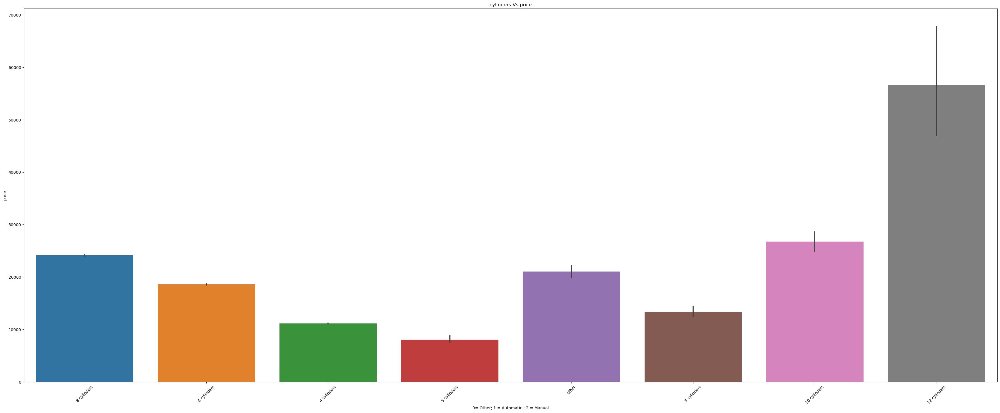

In [87]:
#Transmission of used car and its influence on price
sns.barplot(data=usedcar, x='cylinders', y='price') 
plt.title('cylinders Vs price')
plt.xlabel("0= Other; 1 = Automatic ; 2 = Manual")
plt.xticks(rotation=45)
plt.show()

In [23]:
# Year Vs. Price Distribution
# ##sns does not give the clear plot hence using plotly
# sns.barplot(data=usedcar, x='year', y='price') 
# plt.title('year Vs price')

px.histogram(data_frame=usedcar, x='year', y='price')


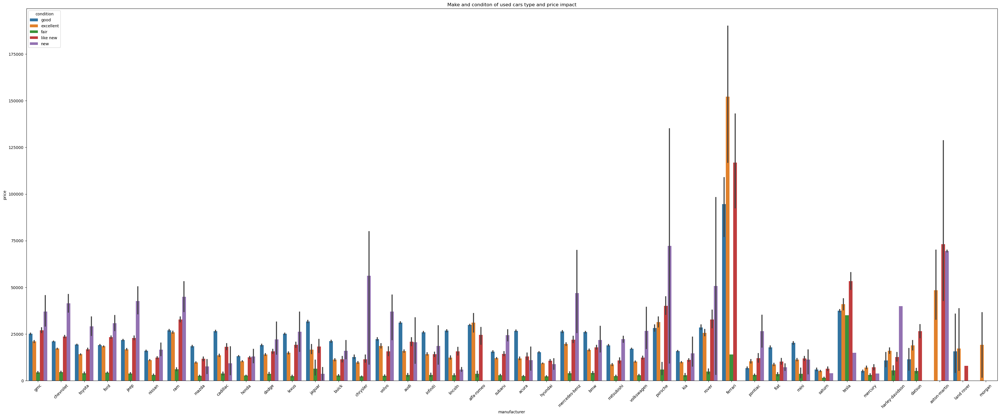

In [24]:
#Manufacturer with car type and its impact to price
from matplotlib import rcParams
rcParams['figure.figsize'] = 44,17
sns.barplot(data=usedcar.query("condition in ['excellent', 'good', 'like new', 'new', 'fair']"), x='manufacturer', y='price', hue='condition')
plt.xticks(rotation=45)
plt.title('Make and conditon of used cars type and price impact')
plt.show()

In [25]:
usedcar.shape, usedcar.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 390095 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            390095 non-null  int64  
 1   region        390095 non-null  object 
 2   price         390095 non-null  int64  
 3   year          388922 non-null  float64
 4   manufacturer  374391 non-null  object 
 5   model         385553 non-null  object 
 6   condition     240647 non-null  object 
 7   cylinders     231713 non-null  object 
 8   fuel          387502 non-null  object 
 9   odometer      387813 non-null  float64
 10  title_status  382368 non-null  object 
 11  transmission  388274 non-null  object 
 12  VIN           239984 non-null  object 
 13  drive         271351 non-null  object 
 14  size          108884 non-null  object 
 15  type          306023 non-null  object 
 16  paint_color   274610 non-null  object 
 17  state         390095 non-null  object 
dtypes: f

((390095, 18), None)

In [26]:
# Check on the unique counts of the object columns

unique_counts_df = pd.DataFrame(columns=['feature', 'unique_count'])

for column in usedcar.select_dtypes(include='object').columns:
    unique_counts_df.loc[len(unique_counts_df.index)] = [column, usedcar[column].nunique()] 
    
unique_counts_df


,feature,unique_count
0,region,404
1,manufacturer,42
2,model,27975
3,condition,6
4,cylinders,8
5,fuel,5
6,title_status,6
7,transmission,3
8,VIN,105438
9,drive,3


In [27]:
# Here replacing categorical features, which has less than 5 values, with numeric values. For features with more than 
# 5 categorical values, I am going to use "one hot encoder" method


#Assigning numeric value for "drive" categorical feature
usedcar['drive'] = usedcar['drive'].str.replace(r'4wd','1')
usedcar['drive'] = usedcar['drive'].str.replace(r'fwd','1')
usedcar['drive'] = usedcar['drive'].str.replace(r'rwd','2')
usedcar[['drive']] = usedcar[['drive']].fillna('0')
usedcar.drive = usedcar.drive.astype(np.int64)




#similary replacing "transmission" with numeric values
usedcar['transmission'] = usedcar['transmission'].str.replace(r'other','0')
usedcar['transmission'] = usedcar['transmission'].str.replace(r'automatic','1')
usedcar['transmission'] = usedcar['transmission'].str.replace(r'manual','2')
usedcar[['transmission']] = usedcar[['transmission']].fillna('0')
usedcar.transmission = usedcar.transmission.astype(np.int64)



#Assigning numeric value for "fuel" categorical feature
usedcar['fuel'] = usedcar['fuel'].str.replace(r'gas','1')
usedcar['fuel'] = usedcar['fuel'].str.replace(r'hybrid','1')
usedcar['fuel'] = usedcar['fuel'].str.replace(r'diesel','2')
usedcar['fuel'] = usedcar['fuel'].str.replace(r'other','3')
usedcar['fuel'] = usedcar['fuel'].str.replace(r'electric','4')
usedcar[['fuel']] = usedcar[['fuel']].fillna('0')
usedcar.drive = usedcar.drive.astype(np.int64)



#Assigning numeric value for "size" categorical feature
usedcar['size'] = usedcar['size'].str.replace(r'compact','1')
usedcar['size'] = usedcar['size'].str.replace(r'mid-size','1')
usedcar['size'] = usedcar['size'].str.replace(r'full-size','2')
usedcar['size'] = usedcar['size'].str.replace(r'sub-compact','3')
usedcar[['size']] = usedcar[['fuel']].fillna('0')
usedcar.drive = usedcar.drive.astype(np.int64)

In [28]:
# BASED ON ABOVE INFORMATION, THERE ARE MULTIPLE FEATRES WITH NULL VALUES FOR 'YEAR', 'MANUFACTURER', 'MODEL', 'CONDITION'
# , 'CYLINDERS', 'FUEL', 'ODOMETER', 'TITLE_STATUS', 'TRANSMISSION', 'VIN', 'DRIVE', 'SIZE', 'TYPE', 'PAINT_COLOR' AND THERE 
# IS NO RELIABLE WAY TO REPLACE THESE NULL DATA WITHOUT INTRODUCING SOME BIAS TO THE MODEL. 
# AFTER CAREFULLY ANALYSIS OF MISSING DATA, WE NEED TO MORPH THE DATA FOR THOSE FEATURES WHICH ARE IMPACTFUL TO THE PRICE 
# PREDICTION AND DROP FOR OTHERS.


# VIN identifies the unique car and has a lot of null values. It does not impact the preice prediction and 
# the can be safely removed
# df = usedcar['VIN'].dropna()

# MODEL feature has 29k+ unique values which can not be possibly categorized. Although it may play as a key factor to price
# prediction but still better to drop to avoid introducing error/bias to the model

df = usedcar.dropna(subset = ['VIN', 'model'])



In [29]:
# Check on the unique counts after removing null values from 'VIN' and 'model' columns
unique_counts_clean = pd.DataFrame(columns=['feature', 'unique_count'])

for column in df.select_dtypes(include='object').columns:
    unique_counts_clean.loc[len(unique_counts_clean.index)] = [column, df[column].nunique()] 
    
unique_counts_clean

,feature,unique_count
0,region,404
1,manufacturer,41
2,model,16905
3,condition,6
4,cylinders,8
5,fuel,5
6,title_status,6
7,VIN,104945
8,size,5
9,type,13


In [30]:
# key driving factor for used car price should be:-

# Based on the above analysis and availability of data, we choose the following features for our model: 
# 'price', 'year', 'manufacturer', 'model', 'condition', 'cylinders', 'fuel', 'odometer', 'title_status', 
# 'transmission',  'type', 'drive'as input features and price as the obvious target variable

#Extracting features that will be used for model development into a separate dataframe df
df = usedcar[['price', 'year', 'manufacturer', 'model', 'condition', 'cylinders', 'fuel', 'odometer', 'title_status', 'transmission',  'type', 'drive']]

#dropping NaN values from the dataframe df
df=df.dropna()
df.shape


(140442, 12)

In [31]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 140442 entries, 27 to 426878
Data columns (total 12 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         140442 non-null  int64  
 1   year          140442 non-null  float64
 2   manufacturer  140442 non-null  object 
 3   model         140442 non-null  object 
 4   condition     140442 non-null  object 
 5   cylinders     140442 non-null  object 
 6   fuel          140442 non-null  object 
 7   odometer      140442 non-null  float64
 8   title_status  140442 non-null  object 
 9   transmission  140442 non-null  int64  
 10  type          140442 non-null  object 
 11  drive         140442 non-null  int64  
dtypes: float64(2), int64(3), object(7)
memory usage: 13.9+ MB


In [32]:
df.describe()

,price,year,odometer,transmission,drive
count,140442.000000,140442.000000,140442.000000,140442.000000,140442.000000
mean,17285.598112,2010.032505,101128.945380,0.900016,1.062666
std,13804.176696,9.364510,68140.506473,0.468776,0.578138
min,100.000000,1900.000000,0.000000,0.000000,0.000000
25%,6500.000000,2007.000000,45958.000000,1.000000,1.000000
50%,12995.000000,2012.000000,97113.000000,1.000000,1.000000
75%,25995.000000,2016.000000,143656.500000,1.000000,1.000000
max,349999.000000,2022.000000,999999.000000,2.000000,2.000000


In [33]:
df.head()

,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,type,drive
27,33590,2014.0,gmc,sierra 1500 crew cab slt,good,8 cylinders,1,57923.0,clean,0,pickup,0
28,22590,2010.0,chevrolet,silverado 1500,good,8 cylinders,1,71229.0,clean,0,pickup,0
29,39590,2020.0,chevrolet,silverado 1500 crew,good,8 cylinders,1,19160.0,clean,0,pickup,0
30,30990,2017.0,toyota,tundra double cab sr,good,8 cylinders,1,41124.0,clean,0,pickup,0
31,15000,2013.0,ford,f-150 xlt,excellent,6 cylinders,1,128000.0,clean,1,truck,2


In [89]:
# categorical values in rest of the object columns
object_col = ['cylinders', 'fuel',
       'title_status', 'transmission', 'drive',  'type']

for i in object_col:
    print('=>',i,'<=')
    print(df[i].unique().tolist())
    print(' ')
  

=> cylinders <=
['8 cylinders', '6 cylinders', '4 cylinders', '5 cylinders', '10 cylinders', '3 cylinders', 'other', '12 cylinders']
 
=> fuel <=
['1', '2', '3', '4']
 
=> title_status <=
['clean', 'rebuilt', 'lien', 'salvage', 'missing', 'parts only']
 
=> transmission <=
[0, 1, 2]
 
=> drive <=
[0, 2, 1]
 
=> type <=
['pickup', 'truck', 'other', 'coupe', 'mini-van', 'SUV', 'sedan', 'hatchback', 'offroad', 'convertible', 'wagon', 'van', 'bus']
 


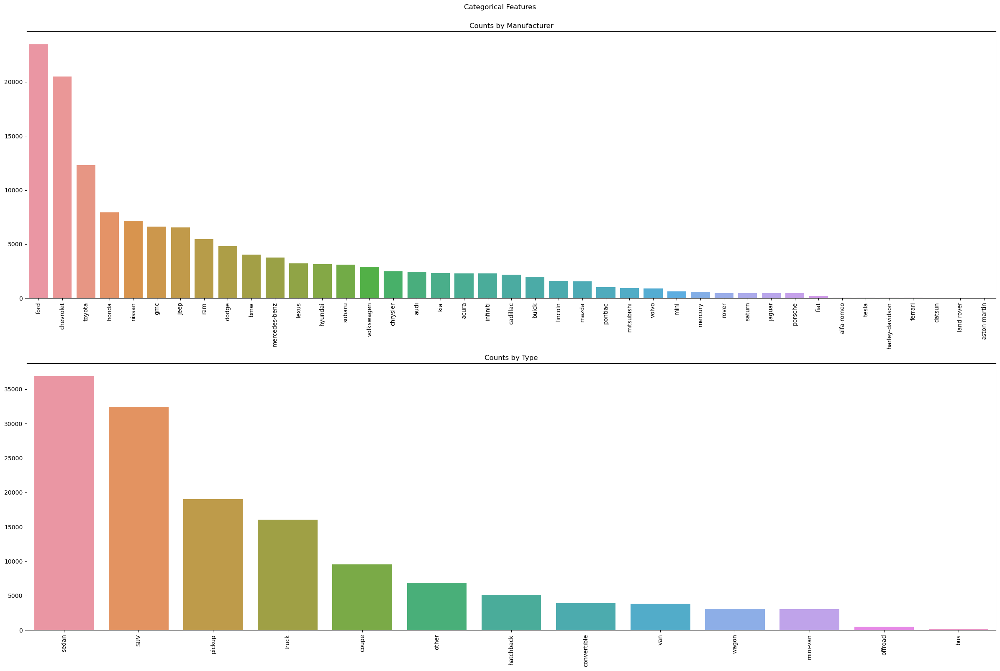

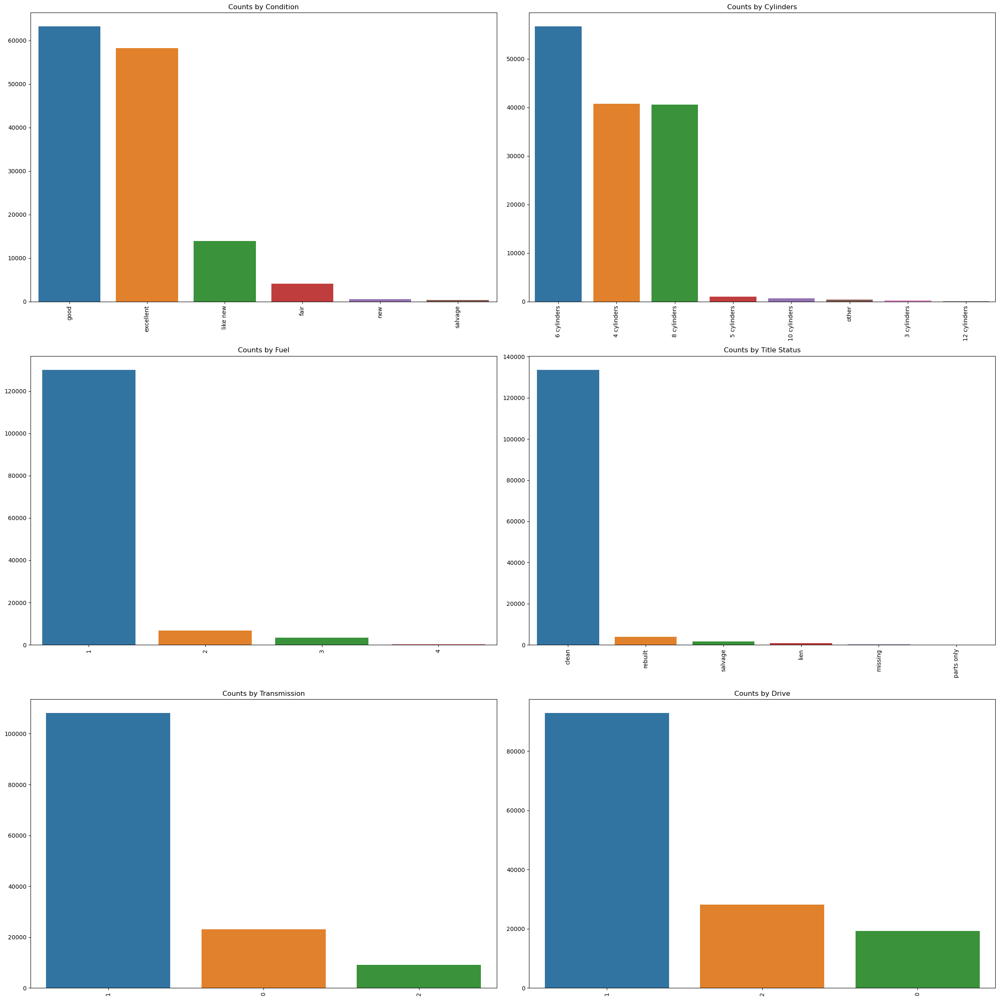

In [35]:
fig, ax = plt.subplots(2, 1, figsize=(24,16))
fig.suptitle('Categorical Features', y=1.)

plot0 = sns.countplot(x='manufacturer', data=df, ax=ax[0], order = df['manufacturer'].value_counts().index);
plot0.set_title("Counts by Manufacturer")
plot0.set_xticklabels(plot0.get_xticklabels(),rotation = 90)
plot0.set(xlabel=None, ylabel=None)


plot1 = sns.countplot(x='type', data=df, ax=ax[1],order = df['type'].value_counts().index);
plot1.set_title("Counts by Type")
plot1.set_xticklabels(plot1.get_xticklabels(),rotation = 90)
plot1.set(xlabel=None, ylabel=None)

fig.tight_layout()

# -------------------------
fig, ax = plt.subplots(3, 2, figsize=(24,24))

plot2 = sns.countplot(x='condition', data=df, ax=ax[0,0],order = df['condition'].value_counts().index);
plot2.set_title("Counts by Condition")
plot2.set_xticklabels(plot2.get_xticklabels(),rotation = 90)
plot2.set(xlabel=None, ylabel=None)

plot3 = sns.countplot(x='cylinders', data=df, ax=ax[0,1],order = df['cylinders'].value_counts().index);
plot3.set_title("Counts by Cylinders")
plot3.set_xticklabels(plot3.get_xticklabels(),rotation = 90)
plot3.set(xlabel=None, ylabel=None)

plot4 = sns.countplot(x='fuel', data=df, ax=ax[1,0],order = df['fuel'].value_counts().index);
plot4.set_title("Counts by Fuel")
plot4.set_xticklabels(plot4.get_xticklabels(),rotation = 90)
plot4.set(xlabel=None, ylabel=None)

plot5 = sns.countplot(x='title_status', data=df, ax=ax[1,1],order = df['title_status'].value_counts().index);
plot5.set_title("Counts by Title Status")
plot5.set_xticklabels(plot5.get_xticklabels(),rotation = 90)
plot5.set(xlabel=None, ylabel=None)
### ------------
### Observation: almost all the titles have the clean status

plot6 = sns.countplot(x='transmission', data=df, ax=ax[2,0],order = df['transmission'].value_counts().index);
plot6.set_title("Counts by Transmission")
plot6.set_xticklabels(plot6.get_xticklabels(),rotation = 90)
plot6.set(xlabel=None, ylabel=None)

plot7 = sns.countplot(x='drive', data=df, ax=ax[2,1],order = df['drive'].value_counts().index);
plot7.set_title("Counts by Drive")
plot7.set_xticklabels(plot7.get_xticklabels(),rotation = 90)
plot7.set(xlabel=None, ylabel=None)


fig.tight_layout()

<AxesSubplot:>

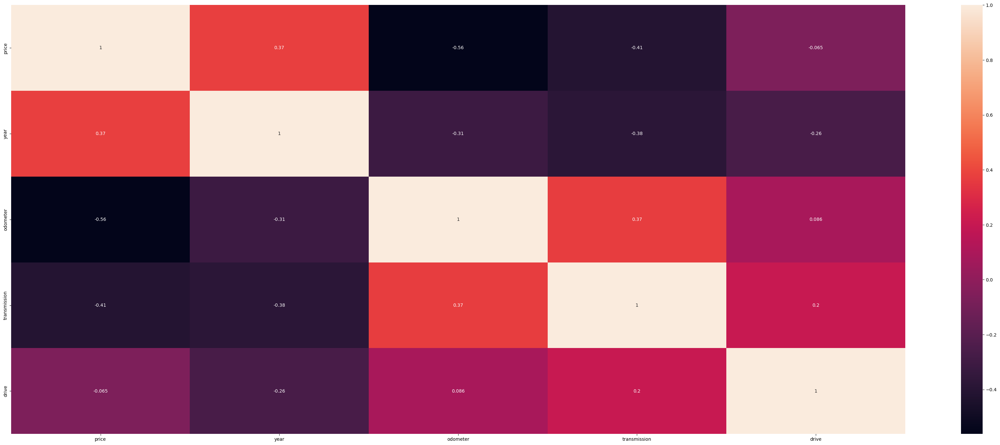

In [36]:
sns.heatmap(df.corr(), annot=True)

In [37]:
# checking missing value
df.isna().sum()
df.isna().sum().index

Index(['price', 'year', 'manufacturer', 'model', 'condition', 'cylinders',
       'fuel', 'odometer', 'title_status', 'transmission', 'type', 'drive'],
      dtype='object')

In [38]:
# # creagting dummie with one hot encoding
final_df = pd.get_dummies(df,columns = ['price', 'year', 'manufacturer', 'model', 'condition', 'cylinders',
       'fuel', 'odometer', 'title_status', 'transmission', 'type', 'drive'], drop_first=True)
final_df.head()



,price_103,price_114,price_116,price_119,price_120,price_123,price_124,price_127,price_131,price_133,...,type_mini-van,type_offroad,type_other,type_pickup,type_sedan,type_truck,type_van,type_wagon,drive_1,drive_2
27,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
28,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
29,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
30,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
31,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,1


In [91]:
#Converting Categorical Columns to Numerical Columns using Target Encoder. THis is additional step I am taking however 
# this is not required after one hot encoding. 
# this dataframe will be used in rest of the further process for pipeline creation

from sklearn import preprocessing
from tqdm import tqdm

numeric_col = ['price', 'year',  'transmission', 'drive', 'odometer']
categorical_col = ['manufacturer', 'model','cylinders', 'condition', 'fuel', 'title_status', 'type']

#Converting Categorical Columns to Numerical Columns using Target Encoder
encoder_df=df.copy()

encoder=preprocessing.LabelEncoder()

def encode(data):
    noNaN = np.array(data.dropna())
    impute_ordinal = encoder.fit_transform(noNaN.reshape(-1,1))
    data.loc[data.notnull()] = np.squeeze(impute_ordinal)
    return data

for i in tqdm(range(len(categorical_col))):
    encode(encoder_df[categorical_col[i]])



100%|█████████████████████████████████████████████| 7/7 [00:00<00:00, 17.96it/s]


In [47]:
encoder_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 140442 entries, 27 to 426878
Data columns (total 12 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         140442 non-null  int64  
 1   year          140442 non-null  float64
 2   manufacturer  140442 non-null  object 
 3   model         140442 non-null  object 
 4   condition     140442 non-null  object 
 5   cylinders     140442 non-null  object 
 6   fuel          140442 non-null  object 
 7   odometer      140442 non-null  float64
 8   title_status  140442 non-null  object 
 9   transmission  140442 non-null  int64  
 10  type          140442 non-null  object 
 11  drive         140442 non-null  int64  
dtypes: float64(2), int64(3), object(7)
memory usage: 13.9+ MB


In [90]:
encoder_df.head()

,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,type,drive
27,33590,2014.0,14,9921,2,6,0,57923.0,0,0,8,0
28,22590,2010.0,7,10095,2,6,0,71229.0,0,0,8,0
29,39590,2020.0,7,10108,2,6,0,19160.0,0,0,8,0
30,30990,2017.0,38,11632,2,6,0,41124.0,0,0,8,0
31,15000,2013.0,13,5089,0,5,0,128000.0,0,1,10,2


# Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

In [48]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import RidgeCV
from sklearn import preprocessing
from sklearn.preprocessing import PolynomialFeatures, OneHotEncoder, OrdinalEncoder
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split, GridSearchCV, LeaveOneOut, KFold, cross_val_score
from sklearn.compose import make_column_transformer, make_column_selector
from sklearn import set_config

set_config(display="diagram") #setting this will display the pipelines 




In [49]:

X = encoder_df.drop(columns=['price']) #input features excluding target variable
y = encoder_df['price']  #target variable

# split into test and train data set
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 42)

print(f'{X_train.shape},{X_test.shape}')
print(f'{y_train.shape},{y_test.shape}')
print(type(X_train))
print(type(y_train))


(105331, 11),(35111, 11)
(105331,),(35111,)
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.series.Series'>


In [50]:
# %%time
# # ******* Linear Regression ********

# # import the required library
# from sklearn.linear_model import LinearRegression
# from sklearn.metrics import mean_squared_error
# from sklearn.metrics import r2_score

# # initiate and fit
# linreg = LinearRegression()
# linreg.fit(X_train, y_train)
# y_pred = linreg.predict(X_test)
# mse = mean_squared_error(y_test, y_pred)
# rmse = np.sqrt(mse)
# r2 = r2_score(y_test, y_pred)

# print(f'LinearReg MSE: {mse}')
# print(f'LinearReg RMSE: {rmse}')
# print(f'LinearReg R2 Score: {r2}')

LinearReg MSE: 92624340.72045544
LinearReg RMSE: 9624.154026222535
LinearReg R2 Score: 0.5074102966919432
CPU times: user 223 ms, sys: 22.6 ms, total: 246 ms
Wall time: 152 ms


In [51]:
%%time
# ******* Linear Regression ********


# initiate and fit

linear_pipe = Pipeline([('scale', StandardScaler()),
                     ('linreg', LinearRegression())])
    
linear_pipe.fit(X_train, y_train)
ln_train_preds = linear_pipe.predict(X_train)
ln_y_preds = linear_pipe.predict(X_test)
# ln_train_mse = mean_squared_error(y_train, ln_y_preds)
ln_test_mse = mean_squared_error(y_test, ln_y_preds)
ln_train_r2score = r2_score(y_train, ln_train_preds)
ln_test_r2score = r2_score(y_test, ln_y_preds)

#print train and test scores for the model 
print ('\nLinear Regression Model: Model Scores and Coefficients\n\n')
# print('Train MSE:',np.around(ln_train_mse,2))
print('Train r2 score:', np.around(ln_train_r2score,2))
print('*==============*')
print('Test MSE:',np.around(ln_test_mse,2))
print('Test RMSE:', np.around(np.sqrt(ln_test_mse),2))
print('Test r2 score:', np.around(ln_test_r2score,2))



Linear Regression Model: Model Scores and Coefficients


Train r2 score: 0.51
*==============*
Test MSE: 92624340.72
Test RMSE: 9624.15
Test r2 score: 0.51
CPU times: user 711 ms, sys: 37.6 ms, total: 749 ms
Wall time: 333 ms


In [53]:
# coefficients of the model
ln_coefs = linear_pipe.named_steps['linreg'].coef_

list_ln_coeff = list((zip(linear_pipe.named_steps['scale'].get_feature_names_out(), linear_pipe.named_steps['linreg'].coef_)))

df_ln_coeff = pd.DataFrame(list_ln_coeff, columns = [' Features', 'linear Coefficients'])

#sort features by magnitude of linear regression coefficents
df_ln_coeff.sort_values(by='linear Coefficients', ascending=False, key=abs)



,Features,linear Coefficients
6,odometer,-6208.387329
4,cylinders,4273.269345
0,year,3330.992993
5,fuel,1910.994485
8,transmission,-821.819268
7,title_status,-819.017386
3,condition,379.485919
1,manufacturer,325.943660
2,model,302.227352
10,drive,224.729391


In [55]:
# Ridge Regression with GridSearchCV for the 'best' alpha

# building a Ridge Regression model using GridSearchCV for tuning hyperparameter 'alpha'

pipeRidge = Pipeline( [('scale', StandardScaler()),('ridge', Ridge())])
param_dict = {'ridge__alpha': [0.001, 0.1, 1.0, 10.0, 100.0, 500.0, 1000.0]}
gridRidge = GridSearchCV(pipeRidge, param_grid=param_dict)
gridRidge.fit(X_train, y_train)
train_predsRidge = gridRidge.predict(X_train)
test_predsRidge = gridRidge.predict(X_test)
# train_mseRidge = mean_squared_error(y_train, train_predsRidge)
train_r2scoreRidge = r2_score(y_train, train_predsRidge)
test_mseRidge = mean_squared_error(y_test, test_predsRidge)
test_r2scoreRidge = r2_score(y_test, test_predsRidge)
best_alphaRidge = gridRidge.best_params_

# print best alpha and model train and test scores
print ('\nRidge Regression Model: Best Alpha and Model Scores\n\n')
print(f'Best Alpha: {list(best_alphaRidge.values())[0]}')
# print('Train MSE:',np.around(train_mseRidge,2))
print('Train r2 score:', np.around(train_r2scoreRidge,2))
print('Test MSE:',np.around(test_mseRidge,2))
print('Test RMSE:', np.around(np.sqrt(test_mseRidge),2))
print('Test r2 score:', np.around(test_r2scoreRidge,2))


Ridge Regression Model: Best Alpha and Model Scores


Best Alpha: 10.0
Train r2 score: 0.51
Test MSE: 92624166.29
Test RMSE: 9624.14
Test r2 score: 0.51


In [56]:
#Inspect the coefficients of the ridge model with best alpha=10.0
pipe_bestalpha_ridge = Pipeline([('scale', StandardScaler()), ('ridge', Ridge(alpha=10.0))])
pipe_bestalpha_ridge.fit(X_train, y_train)


list_Ridge_coeff = list((zip(pipe_bestalpha_ridge.named_steps['scale'].get_feature_names_out(), pipe_bestalpha_ridge.named_steps['ridge'].coef_)))

df_Ridge_coeff = pd.DataFrame(list_Ridge_coeff, columns = [' Features', 'Ridge Coefficients'])

print('\nRidge Regression Coefficients\n\n')

#sort features by magnitude of ridge regression coefficents
df_Ridge_coeff.sort_values(by='Ridge Coefficients', ascending=False, key=abs)




Ridge Regression Coefficients




,Features,Ridge Coefficients
6,odometer,-6207.752925
4,cylinders,4272.735863
0,year,3330.667291
5,fuel,1910.886367
8,transmission,-822.222315
7,title_status,-818.927779
3,condition,379.520740
1,manufacturer,325.779300
2,model,302.249087
10,drive,224.711711


In [57]:
# Lasso Model with GridSearchCV for optimal lasso alpha
#Next implementing the lasso model : picking the best alpha parameter for the lasso model

lasso_alphas = [0.001,0.01,0.1,1.0, 10.0]
lasso = Lasso(random_state=123)
grid = dict()
grid['alpha'] = lasso_alphas

gscv_lasso = GridSearchCV( \
    lasso, grid, scoring='neg_mean_squared_error', \
    cv=3, n_jobs=-1)

gscv_lasso.fit(X_train, y_train)
train_predsLasso = gscv_lasso.predict(X_train)
test_predsLasso = gscv_lasso.predict(X_test)
train_mseLasso = mean_squared_error(y_train, train_predsLasso)
train_r2scoreLasso = r2_score(y_train, train_predsLasso)
test_mseLasso = mean_squared_error(y_test, test_predsLasso)
test_r2scoreLasso = r2_score(y_test, test_predsLasso)
best_alphaLasso = gscv_lasso.best_params_

# print best alpha and model train and test scores for Lasso model
print ('\nLasso Model: Best Alpha and Model Scores\n\n')
print(f'Best Alpha: {list(best_alphaLasso.values())[0]}')
print('Train MSE:',np.around(train_mseLasso,2))
print('Train r2 score:', np.around(train_r2scoreLasso,2))
print('Test MSE:',np.around(test_mseLasso,2))
print('Test RMSE:', np.around(np.sqrt(test_mseLasso),2))
print('Test r2 score:', np.around(test_r2scoreLasso,2))



Lasso Model: Best Alpha and Model Scores


Best Alpha: 0.001
Train MSE: 93655698.11
Train r2 score: 0.51
Test MSE: 92624339.54
Test RMSE: 9624.15
Test r2 score: 0.51


In [58]:
#Inspect the coefficients of the Lasso model with best alpha=0.001
pipe_bestalpha_lasso = Pipeline([('scale', StandardScaler()), ('lasso', Lasso(alpha=0.001, random_state=123))])
pipe_bestalpha_lasso.fit(X_train, y_train)

list_Lasso_coeff = list((zip(pipe_bestalpha_lasso.named_steps['scale'].get_feature_names_out(), pipe_bestalpha_lasso.named_steps['lasso'].coef_)))

df_Lasso_coeff = pd.DataFrame(list_Lasso_coeff, columns = [' Features', 'Lasso Coefficients'])

print('\nLasso Coefficients\n\n')

#sort features by magnitude of lasso coefficents
df_Lasso_coeff.sort_values(by='Lasso Coefficients', ascending=False, key=abs)



Lasso Coefficients




,Features,Lasso Coefficients
6,odometer,-6208.386611
4,cylinders,4273.268601
0,year,3330.992082
5,fuel,1910.993823
8,transmission,-821.819058
7,title_status,-819.016428
3,condition,379.485229
1,manufacturer,325.942259
2,model,302.226224
10,drive,224.727920


In [60]:
# Sequential Feature Selection using Linear Regression Estimator
from sklearn.feature_selection import SequentialFeatureSelector, SelectFromModel

#SequentialFeature selector with number of features = 5 and LinearRegression estimator
pipeSFSelector = Pipeline([('scale', StandardScaler()),('linreg', LinearRegression())])
SFSelector = SequentialFeatureSelector(pipeSFSelector, n_features_to_select=5)

#best four features from Sequential Feature Selection
best_features_SFSelector = SFSelector.fit_transform(X_train, y_train)
best_featuresSFSelector_df = pd.DataFrame(best_features_SFSelector, columns = SFSelector.get_feature_names_out())
best_featuresSFSelector_df.head()



,year,cylinders,fuel,odometer,title_status
0,2014.0,6,0,53263.0,0
1,2010.0,3,0,133254.0,0
2,2009.0,5,0,156022.0,0
3,1982.0,6,0,140000.0,0
4,2007.0,5,0,225752.0,0


In [61]:
#pipeline with column selector from Sequential Feature Selection
pipelineSFSLR = Pipeline([('column_selector', SFSelector),
                  ('scale', StandardScaler()),
                ('linreg', LinearRegression())])

pipelineSFSLR.fit(X_train, y_train)
train_preds_SFSLR = pipelineSFSLR.predict(X_train)
y_preds_SFSLR = pipelineSFSLR.predict(X_test)
train_mse_SFSLR = mean_squared_error(y_train, train_preds_SFSLR)
train_r2score_SFSLR = r2_score(y_train, train_preds_SFSLR)
test_mse_SFSLR = mean_squared_error(y_test, y_preds_SFSLR)
test_r2score_SFSLR = r2_score(y_test, y_preds_SFSLR)

# print  model train and test scores for SFS with LR
print ('\nSequential Feature Selection With Linear Regression Estimator: Model Scores and Coefficients\n\n')
print('Train MSE:',np.around(train_mse_SFSLR,2))
print('Train r2 score:', np.around(train_r2score_SFSLR,2))
print('Test MSE:',np.around(test_mse_SFSLR,2))
print('Test RMSE:', np.around(np.sqrt(test_mse_SFSLR),2))
print('Test r2 score:', np.around(test_r2score_SFSLR,2))


list_SFSLR_coeff = list((zip(pipelineSFSLR['column_selector'].get_feature_names_out(), pipelineSFSLR['linreg'].coef_)))

df_SFSLR_coeff = pd.DataFrame(list_SFSLR_coeff, columns = ['SFS Features', 'Model Coefficients'])

#sort features by magnitude of model coefficents
df_SFSLR_coeff.sort_values(by='Model Coefficients', ascending=False, key=abs)



Sequential Feature Selection With Linear Regression Estimator: Model Scores and Coefficients


Train MSE: 94535950.13
Train r2 score: 0.51
Test MSE: 93546280.41
Test RMSE: 9671.93
Test r2 score: 0.5


,SFS Features,Model Coefficients
3,odometer,-6438.948779
1,cylinders,4500.433135
0,year,3582.412372
2,fuel,1965.733629
4,title_status,-871.951460


In [ ]:


# Sequential Feature Selection showed how a simpler model can built with fewer (5) features, where the top features in order of magnitude of coefficients, and hence in the order of highest (positive or negative) impact on price are:

#     Model (positive)

#     Odomoter (negative)

#     Year (positive)

#     Transmission (negative)

#     Fuel (positive)


In [62]:

# Higher Order Regression Models with Polynomial Features

# Next we evaluate the effect of increasing complexity with PolynomialFeatures and iterating through different 
# complexites from degree = 1 through degree = 4 and a LinearRegession estimator. We evaluate the best complexity 
# based on the test mean squared error.



Linear Regression with Higher Order Polynomials



Best complexity: 3

Test MSEs:
 [92624340.72 58922805.81 48899768.1  52191560.01]

Test RMSEs:
 [9624.15 7676.12 6992.84 7224.37]

Test r2 scores:
 [0.51 0.69 0.74 0.72]


Text(0.5, 1.0, 'Selection of Optimal Model Complexity\nBased on Test MSE')

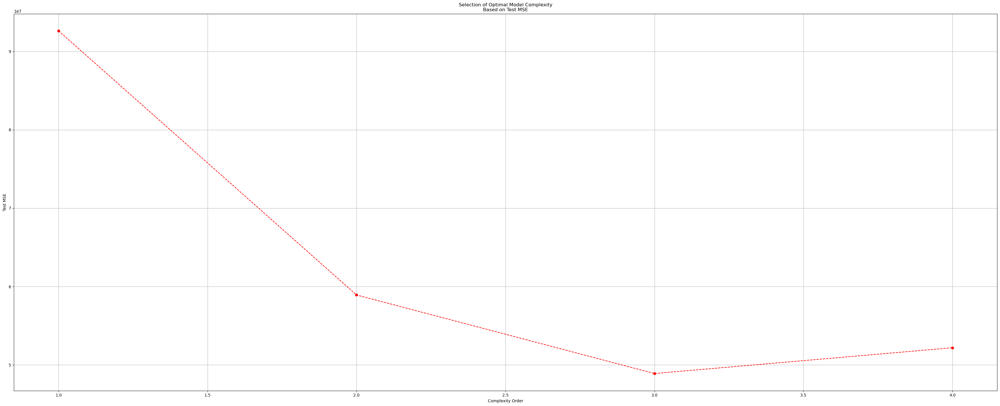

In [94]:
# building a pipeline model with polynomial features and linear regression to test different  models of increasing 
# complexity

train_mses = []
train_r2score=[]
test_mses = []
test_r2score=[]
for i in range(1, 5):
    pipe = Pipeline([('pfeat', PolynomialFeatures(degree = i, include_bias=False)),
                     ('scale', StandardScaler()),
                     ('linreg', LinearRegression())])
    
    pipe.fit(X_train, y_train)
    train_preds = pipe.predict(X_train)
    y_preds = pipe.predict(X_test)
    train_mses.append(mean_squared_error(y_train, train_preds))
    test_mses.append(mean_squared_error(y_test, y_preds))
    train_r2score.append(r2_score(y_train, train_preds))
    test_r2score.append(r2_score(y_test, y_preds))

    
# find the best model complexity best on the testing error (and not training error)
best_model_complexity = test_mses.index(min(test_mses)) + 1

print('\nLinear Regression with Higher Order Polynomials\n')
print('\n\nBest complexity:' , best_model_complexity)
print('\nTest MSEs:\n', np.around(test_mses,2))
print('\nTest RMSEs:\n', np.around(np.sqrt(test_mses),2))
print('\nTest r2 scores:\n', np.around(test_r2score,2))

plt.plot(np.arange(1,5), test_mses, 'ro--')
plt.grid()
plt.xlabel('Complexity Order')
plt.ylabel('Test MSE')
plt.title('Selection of Optimal Model Complexity\nBased on Test MSE')

In [67]:
linreg_coeffs = pd.Series(linreg.coef_, index=X_train.columns)
linreg_coeffs.sort_values(ascending=False)

fuel            5015.709998
cylinders       3475.902264
drive            389.245133
year             356.806036
condition        336.200475
manufacturer      29.048631
type              24.205753
model              0.084927
odometer          -0.090922
title_status    -965.134283
transmission   -1758.543651
dtype: float64

In [64]:

# Ridge Regression with Higher Order Polynomial (degree =3) and GridSearchCV for optimal alpha

pipe_Ridge = Pipeline( [('pfeat', PolynomialFeatures(degree = 3, include_bias=False)), ('scale', StandardScaler()),('ridge', Ridge())])
param_dict = {'ridge__alpha': [0.001, 0.1, 1.0, 10.0, 100.0]}
grid_Ridge = GridSearchCV(pipe_Ridge, param_grid=param_dict)
grid_Ridge.fit(X_train, y_train)
train_preds_Ridge = grid_Ridge.predict(X_train)
test_preds_Ridge = grid_Ridge.predict(X_test)
train_mse_Ridge = mean_squared_error(y_train, train_preds_Ridge)
train_r2score_Ridge = r2_score(y_train, train_preds_Ridge)
test_mse_Ridge = mean_squared_error(y_test, test_preds_Ridge)
test_r2score_Ridge = r2_score(y_test, test_preds_Ridge)
Ridge_best_alpha = grid_Ridge.best_params_

# print best alpha and corresponding train/test scores
print('\n Ridge Regression with Higher Order Polynomial (degree=3) : Best Alpha and Model Scores\n')
print(f'Best Alpha: {list(Ridge_best_alpha.values())[0]}')
print(f'Train MSE: {np.around(train_mse_Ridge,2)}')
print(f'Train r2 score: {np.around(train_r2score_Ridge,2)}')
print(f'Test MSE: {np.around(test_mse_Ridge,2)}')
print(f'Test RMSE: {np.around(np.sqrt(test_mse_Ridge),2)}')
print(f'Test r2 score: {np.around(test_r2score_Ridge,2)}')




 Ridge Regression with Higher Order Polynomial (degree=3) : Best Alpha and Model Scores

Best Alpha: 0.001
Train MSE: 50457283.94
Train r2 score: 0.74
Test MSE: 51626053.04
Test RMSE: 7185.13
Test r2 score: 0.73


In [66]:
ridgereg = Ridge(alpha=0.001).fit(X_train, y_train)
ridgereg_coeffs = pd.Series(ridgereg.coef_, index=X_train.columns)
ridgereg_coeffs.sort_values(ascending=False)

fuel            5015.709668
cylinders       3475.902266
drive            389.245108
year             356.806038
condition        336.200483
manufacturer      29.048631
type              24.205757
model              0.084927
odometer          -0.090922
title_status    -965.134278
transmission   -1758.543573
dtype: float64

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
 [Text(0, 0, 'year'),
  Text(1, 0, 'manufacturer'),
  Text(2, 0, 'model'),
  Text(3, 0, 'condition'),
  Text(4, 0, 'cylinders'),
  Text(5, 0, 'fuel'),
  Text(6, 0, 'odometer'),
  Text(7, 0, 'title_status'),
  Text(8, 0, 'transmission'),
  Text(9, 0, 'type'),
  Text(10, 0, 'drive')])

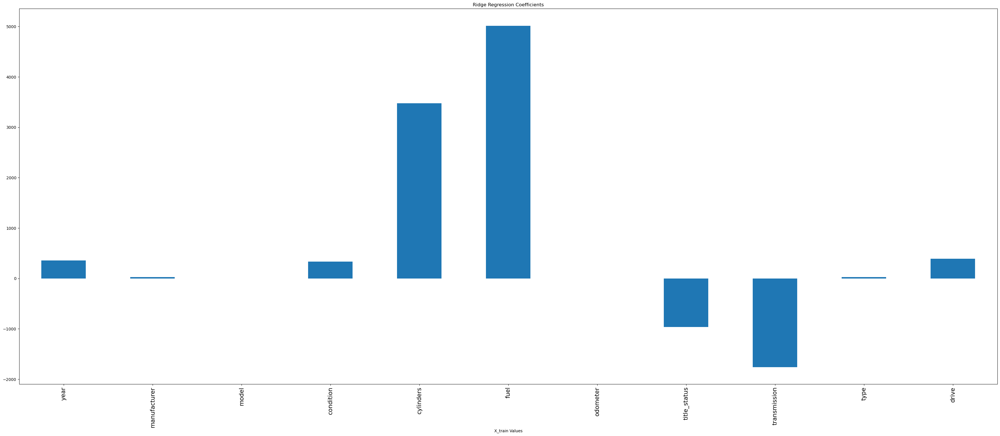

In [70]:
ridgereg_coeffs.plot(kind='bar')
plt.title('Ridge Regression Coefficients')
plt.xlabel('X_train Values')
plt.xticks(size=15)

In [65]:
# Lasso with higher order polynomial and GridSearchCV for optimal alpha

pipelasso = Pipeline([('pfeat', PolynomialFeatures(degree = 3, include_bias=False)), ('scaler', StandardScaler()), 
                     ('lasso', Lasso(random_state=123))])
param_dict = {'lasso__alpha': [0.001, 0.01, 0.1, 1.0, 10.0, 100.0]}



gscv_pipelasso = GridSearchCV( \
    pipelasso, param_grid=param_dict, scoring='neg_mean_squared_error', \
    cv=3, n_jobs=-1)

gscv_pipelasso.fit(X_train, y_train)
train_preds_pipelasso = gscv_pipelasso.predict(X_train)
test_preds_pipelasso = gscv_pipelasso.predict(X_test)
train_mse_pipelasso = mean_squared_error(y_train, train_preds_pipelasso)
train_r2score_pipelasso = r2_score(y_train, train_preds_pipelasso)
test_mse_pipelasso = mean_squared_error(y_test, test_preds_pipelasso)
test_r2score_pipelasso = r2_score(y_test, test_preds_pipelasso)
best_alpha_pipelasso = gscv_pipelasso.best_params_

# print best alpha and model train and test scores for Lasso model
print ('\nLasso Model with 3nd order Polynomial Features: Best Alpha and Model Scores\n\n')
print(f'Best Alpha: {list(best_alpha_pipelasso.values())[0]}')
print('Train MSE:',np.around(train_mse_pipelasso,2))
print('Train r2 score:', np.around(train_r2score_pipelasso,2))
print('Test MSE:',np.around(test_mse_pipelasso,2))
print('Test RMSE:', np.around(np.sqrt(test_mse_pipelasso),2))
print('Test r2 score:', np.around(test_r2score_pipelasso,2))

/Users/mohul1/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.198e+12, tolerance: 1.353e+09
  model = cd_fast.enet_coordinate_descent(
/Users/mohul1/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.193e+12, tolerance: 1.344e+09
  model = cd_fast.enet_coordinate_descent(
/Users/mohul1/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularis


Lasso Model with 3nd order Polynomial Features: Best Alpha and Model Scores


Best Alpha: 1.0
Train MSE: 62301385.72
Train r2 score: 0.67
Test MSE: 63701043.83
Test RMSE: 7981.29
Test r2 score: 0.66


In [68]:
lassoreg = Lasso(alpha=0.001).fit(X_train, y_train)
lassoreg_coeffs = pd.Series(lassoreg.coef_, index=X_train.columns)
lassoreg_coeffs.sort_values(ascending=False)

fuel            5015.703382
cylinders       3475.902776
drive            389.241025
year             356.806069
condition        336.200116
manufacturer      29.048602
type              24.205807
model              0.084926
odometer          -0.090922
title_status    -965.133182
transmission   -1758.537778
dtype: float64

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
 [Text(0, 0, 'year'),
  Text(1, 0, 'manufacturer'),
  Text(2, 0, 'model'),
  Text(3, 0, 'condition'),
  Text(4, 0, 'cylinders'),
  Text(5, 0, 'fuel'),
  Text(6, 0, 'odometer'),
  Text(7, 0, 'title_status'),
  Text(8, 0, 'transmission'),
  Text(9, 0, 'type'),
  Text(10, 0, 'drive')])

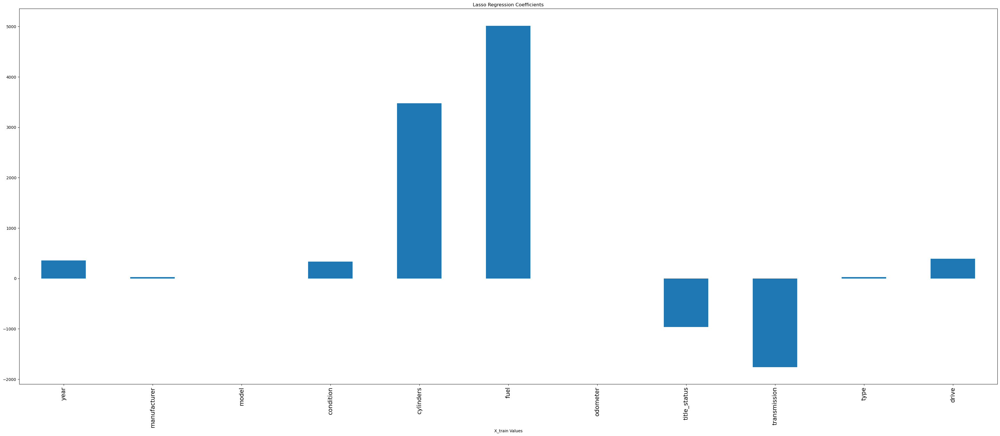

In [69]:
lassoreg_coeffs.plot(kind='bar')
plt.title('Lasso Regression Coefficients')
plt.xlabel('X_train Values')
plt.xticks(size=15)

### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight on drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

In [74]:
#Identifying MSE to choose n_neighbors
from sklearn.neighbors import KNeighborsRegressor

mses=[]
for i in range(1,10):
    KNN=KNeighborsRegressor(n_neighbors=i)
    KNN.fit(X_train,y_train)
    y_pred=KNN.predict(X_test)
    results=np.sqrt(mean_squared_error(y_test, y_pred))
    mses.append(results)
print(mses)



[9154.53068571684, 8582.55516928429, 8373.722288434754, 8389.954364515888, 8438.479356185637, 8511.306141823366, 8583.560680950055, 8639.658433590534, 8692.053636612112]


In [76]:
KNN=KNeighborsRegressor(n_neighbors=2)
KNN.fit(X_train,y_train)
y_pred3=KNN.predict(X_test)


mseKNN = mean_squared_error(y_test, y_pred3)
rmseKNN = np.sqrt(mseKNN)
r2_KNN = r2_score(y_test, y_pred3)

# KNN_best_alpha = lasso_grid.best_params_

print(f'KNN MSE: {mseKNN}')
print(f'KNN RMSE: {rmseKNN}')
print(f'KNN R2 Score: {r2_KNN}')
# print(f'LassoReg Best Alpha: {lasso_best_alpha}')



# KNN_results = model_scores(y_test, y_pred3)
# print(f'KNN MSE: {KNN_results[0]}')
# print(f'KNN RMSE: {KNN_results[1]}')
# print(f'KNN R2 Score: {KNN_results[2]}')

# model_results.append({'Model_name': 'KNN Regression', 'MSE': KNN_results[0], 'RMSE': KNN_results[1], 'R2 Score': KNN_results[2]})



KNN MSE: 73660253.23380849
KNN RMSE: 8582.55516928429
KNN R2 Score: 0.6082640696407685


In [ ]:
# Our best model is second order polynomial model with RIDGE Regression that accepts 8 attributes as input features to 
# predict the price of used cars. We have used hold out cross-validation for our model which works well for most cases. 
# In the evaluation phase, we want to re-test the performance of the model using K-Fold validaton just to make sure our 
# results from the hold out cross-validation are not biased due to any unprecedented reasons. Once again we have to make
# sure test datasets are encoded without utilization of the test values of the target variable to make sure we get 
# unbiased results from K-Fold Cross-Validation



In [78]:
pip install category_encoders
# installed category ecoder for K-fold validation

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.2/81.2 kB 2.7 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [79]:
import category_encoders as ce

In [82]:
# Define the number of folds
n_splits = 5

# Define the cross-validation scheme
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

test_mse_KF =[]
test_rmse_KF=[]
test_r2score_KF=[]

# Define the encoder
encoder = ce.LeaveOneOutEncoder(return_df=True)



# Loop over the folds
for train_index, test_index in kf.split(X):
    # Get the training and test data for this fold
    X_trainKF, X_testKF = X.iloc[train_index], X.iloc[test_index]
    y_trainKF, y_testKF = y.iloc[train_index], y.iloc[test_index]

    # Fit the encoder on the training data for this fold only
    encoder.fit(X_trainKF, y_trainKF)

    # Encode the categorical variables in the training and test data
    X_train_encodedKF = encoder.transform(X_trainKF)
    X_test_encodedKF = encoder.transform(X_testKF)

    # rigde is the best model so 
    pipe_BestModel = pipe_Ridge

    # Fit the best model on the encoded training data
    pipe_BestModel.fit(X_train_encodedKF, y_trainKF)
    # Make predictions on the encoded test data
    y_predKF = pipe_BestModel.predict(X_test_encodedKF)

    # Calculate the test scores for this fold
    test_mse_KF.append(np.around(mean_squared_error(y_testKF, y_predKF),2))
    test_rmse_KF.append(np.around(np.sqrt(mean_squared_error(y_testKF, y_predKF)),2))
    test_r2score_KF.append(np.around(r2_score(y_testKF, y_predKF),2))

    
print('\nKFold Scores for number of splits = 5\n')
print('Test MSEs: \n', test_mse_KF)
print('Mean Test MSE:', np.around(np.mean(test_mse_KF),2))
print('\nTest RMSEs: \n', test_rmse_KF)
print('Mean Test RMSE:', np.around(np.mean(test_rmse_KF),2))
print('\nTest r2 scores:\n', test_r2score_KF)
print('Mean Test r2 score:', np.around(np.mean(test_r2score_KF),2))


KFold Scores for number of splits = 5

Test MSEs: 
 [40693089.59, 40896091.31, 37258684.03, 40379998.26, 42239536.8]
Mean Test MSE: 40293480.0

Test RMSEs: 
 [6379.11, 6395.01, 6103.99, 6354.53, 6499.2]
Mean Test RMSE: 6346.37

Test r2 scores:
 [0.78, 0.79, 0.8, 0.79, 0.78]
Mean Test r2 score: 0.79


In [ ]:
# The result from the K-FOLD is similar to the output from the earlier hold out cross validation. 
# This shows that the model is consistent with test & train data set


In [84]:
from sklearn.inspection import permutation_importance

scoring = ['r2', 'neg_mean_absolute_percentage_error', 'neg_mean_squared_error']
r_multi = permutation_importance(pipe_BestModel, X_test, y_test, n_repeats=30, random_state=0, scoring=scoring)

for metric in r_multi:
    print(f"{metric}")
    r = r_multi[metric]
    for i in r.importances_mean.argsort()[::-1]:
             if r.importances_mean[i] - 2 * r.importances_std[i] > 0:
                print(f"    {X_test.columns[i]:<8}:   "
                        f"{r.importances_mean[i]:.3f}"
                            f" +/- {r.importances_std[i]:.3f}")



r2
    odometer:   0.192 +/- 0.010
    transmission:   0.037 +/- 0.009
    type    :   0.000 +/- 0.000
    cylinders:   0.000 +/- 0.000
    condition:   0.000 +/- 0.000
neg_mean_absolute_percentage_error
    odometer:   0.549 +/- 0.018
    transmission:   0.510 +/- 0.022
    drive   :   0.069 +/- 0.009
    year    :   0.020 +/- 0.006
    manufacturer:   0.000 +/- 0.000
    condition:   0.000 +/- 0.000
neg_mean_squared_error
    odometer:   36122395.876 +/- 1915043.831
    transmission:   6867157.473 +/- 1730809.322
    type    :   33322.472 +/- 3887.622
    cylinders:   12907.541 +/- 946.076
    condition:   11677.192 +/- 306.833


# Recap:

The start was with pulling out used car data with a goal to identify the key factor which influence the price. Along with that, we need to build a model for dealrship to adjust their used car inventory based on the features which are highly desired. 
Next, data was reveiwed, identified outliers, cleaned them up and replace catgorical features with numerical features 
nd applied encoder.
After that, used the train and test set of data on various models and complexities to observe the higher accuracy.


##### In this analysis, RIDGE model with higher Order Polynomial with complexcity degree=3 resulted in higher accuracy as 73%.



### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine tuning their inventory.

### Introduction:

This report aims to provide insights into the top 3 key drivers affecting the pricing of used cars. Our objective is to help used car dealers fine-tune their inventory and pricing strategies based on the findings of our analysis.

#### Methodology:

We analyzed a dataset of used car transactions, focusing on the different attributes such as Model, Manufacturer, Year, Odometer, Title Status, Fuel, Cylinder, and Drive. Our analysis involved performing a multiple regression analysis, where we modeled the sale price of a used car as a function of these attributes. We also used data visualization techniques to explore the relationship between these attributes and the sale price.

#### Findings:

Our analysis revealed the following key findings:

Fuel type: The type of fuel used by a car is a significant driver of its price. Cars that run on diesel or hybrid fuel tend to have higher sale prices compared to cars that run on gasoline.

Cylinder count: The number of cylinders in a car's engine is another key driver of its price. Cars with more cylinders tend to have higher sale prices compared to cars with fewer cylinders.

Drive type: The drive type of a car also plays a significant role in determining its price. Cars with all-wheel drive (AWD) or four-wheel drive (4WD) tend to have higher sale prices compared to cars with front-wheel drive (FWD) or rear-wheel drive (RWD).

#### Recommendations:

Based on our findings, we recommend that used car dealers consider the Fuel, Cylinder, and Drive attributes when setting prices for their inventory. Cars that run on diesel or hybrid fuel, have more cylinders, or feature AWD or 4WD are likely to command higher prices in the market. Dealers should also consider adjusting their pricing strategies for cars with these attributes to better reflect their market value.

### Conclusion:

In conclusion, our analysis highlights the importance of considering key attributes such as Fuel, Cylinder, and Drive when determining the pricing of used cars. By taking these attributes into account, used car dealers can fine-tune their inventory and pricing strategies to better align with market demand, ultimately leading to more successful sales and greater profitability.
